In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/gender-pay-gap-dataset/CurrentPopulationSurvey.csv
/kaggle/input/gender-pay-gap-dataset/PanelStudyIncomeDynamics.csv


I. Dataset Selection: 

There are two datasets: The datasets were not merged - they are not the same underlying data collection, one supplementary dataset was added to create a larger set of data, but it is like comparing apples to oranges. There are 2 files in this collection: a) the Current Population Survey (CPS) and b) the Panel Study of Income Dynamics (PSID) microdata over the 1980-2010 period. The second dataset was used for the years of experience parameter, which is not available in the first dataset. The "wave" in the second dataset refers to the temporal information (years).

In [2]:
#CPS
CPSorig = pd.read_csv(r"/kaggle/input/gender-pay-gap-dataset/CurrentPopulationSurvey.csv",sep=",")
CPS=CPSorig[['year', 'sex', 'race', 'sch', 'hrwage', 'incwage','annhrs', 'manager', 'business', 'financialop','computer', 'architect', 'scientist', 'socialworker', 'postseceduc', 'legaleduc', 'artist', 'lawyerphysician', 'healthcare', 'healthsupport', 'protective', 'foodcare', 'building', 'sales', 'officeadmin', 'farmer', 'production', 'transport', 'constructextractinstall']]

#PSID is a smaller supplementary dataset
PSIDorig = pd.read_csv(r"/kaggle/input/gender-pay-gap-dataset/PanelStudyIncomeDynamics.csv", sep=",")
PSID= PSIDorig[['wave','sex', 'yrsexp', 'hrwage', 'annlabinc','annhrs', 'manager', 'business', 'financialop','computer', 'architect', 'scientist', 'socialworker', 'postseceduc', 'legaleduc', 'artist', 'lawyerphysician', 'healthcare', 'healthsupport', 'protective', 'foodcare', 'building', 'sales', 'officeadmin', 'farmer', 'production', 'transport', 'constructextractinstall']]


What does the data look like?

Dataset #1

In [3]:
CPS.head()

,year,sex,race,sch,hrwage,incwage,annhrs,manager,business,financialop,...,healthsupport,protective,foodcare,building,sales,officeadmin,farmer,production,transport,constructextractinstall
0,1990,1,3,12.0,7.802198,14200.0,1820,0,0,0,...,0,0,0,0,0,1,0,0,0,0
1,2009,1,1,12.0,8.500000,17680.0,2080,0,0,0,...,0,0,0,0,0,1,0,0,0,0
2,1990,1,1,14.0,13.461538,28000.0,2080,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,1990,1,1,18.0,13.002364,27500.0,2115,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,1981,1,4,13.0,8.173077,17000.0,2080,1,0,0,...,0,0,0,0,0,0,0,0,0,0


Dataset #2

In [4]:
PSID.head()

,wave,sex,yrsexp,hrwage,annlabinc,annhrs,manager,business,financialop,computer,...,healthsupport,protective,foodcare,building,sales,officeadmin,farmer,production,transport,constructextractinstall
0,1981,1,12.0,6.250000,10000.0,1600,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
1,1981,1,14.0,17.490385,9095.0,520,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
2,2009,1,39.0,17.725491,45200.0,2550,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
3,1999,1,30.0,8.138021,25000.0,3072,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0
4,1990,1,8.0,11.666667,24500.0,2100,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0


The CPS is an order of magnitude larger in the rows than the PSID.

In [5]:
CPS.shape

(344287, 29)

In [6]:
PSID.shape

(33398, 28)

Looking at the columns that are used in CPS & PSID.

In [7]:
CPS.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 344287 entries, 0 to 344286
Data columns (total 29 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   year                     344287 non-null  int64  
 1   sex                      344287 non-null  int64  
 2   race                     344287 non-null  int64  
 3   sch                      344287 non-null  float64
 4   hrwage                   344287 non-null  float64
 5   incwage                  344287 non-null  float64
 6   annhrs                   344287 non-null  int64  
 7   manager                  344287 non-null  int64  
 8   business                 344287 non-null  int64  
 9   financialop              344287 non-null  int64  
 10  computer                 344287 non-null  int64  
 11  architect                344287 non-null  int64  
 12  scientist                344287 non-null  int64  
 13  socialworker             344287 non-null  int64  
 14  post

In [8]:
PSID.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 33398 entries, 0 to 33397
Data columns (total 28 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   wave                     33398 non-null  int64  
 1   sex                      33398 non-null  int64  
 2   yrsexp                   33398 non-null  float64
 3   hrwage                   33398 non-null  float64
 4   annlabinc                33398 non-null  float64
 5   annhrs                   33398 non-null  int64  
 6   manager                  33398 non-null  int64  
 7   business                 33398 non-null  int64  
 8   financialop              33398 non-null  int64  
 9   computer                 33398 non-null  int64  
 10  architect                33398 non-null  int64  
 11  scientist                33398 non-null  int64  
 12  socialworker             33398 non-null  int64  
 13  postseceduc              33398 non-null  int64  
 14  legaleduc             

Global statistics in the datasets.

In [9]:
CPS.describe()

,year,sex,race,sch,hrwage,incwage,annhrs,manager,business,financialop,...,healthsupport,protective,foodcare,building,sales,officeadmin,farmer,production,transport,constructextractinstall
count,344287.000000,344287.000000,344287.000000,344287.000000,344287.000000,3.442870e+05,344287.000000,344287.000000,344287.000000,344287.000000,...,344287.000000,344287.000000,344287.000000,344287.000000,344287.000000,344287.000000,344287.000000,344287.000000,344287.000000,344287.000000
mean,2002.599122,1.489057,1.570077,13.498057,20.074408,3.976170e+04,2013.196449,0.103681,0.021282,0.022371,...,0.023980,0.022682,0.060545,0.035581,0.088057,0.147072,0.006855,0.086358,0.061800,0.088818
std,10.831555,0.499881,0.952252,2.799038,498.968110,4.529758e+04,599.050382,0.304847,0.144322,0.147887,...,0.152987,0.148887,0.238495,0.185243,0.283379,0.354178,0.082509,0.280893,0.240793,0.284482
min,1981.000000,1.000000,1.000000,0.000000,0.865385,1.500000e+01,1.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1990.000000,1.000000,1.000000,12.000000,9.134615,1.670000e+04,1924.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,2007.000000,1.000000,1.000000,13.000000,14.500000,3.000000e+04,2080.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,2011.000000,2.000000,2.000000,16.000000,23.557692,5.000000e+04,2080.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,2013.000000,2.000000,4.000000,18.000000,290000.000000,1.259999e+06,5148.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [10]:
PSID.describe()

,wave,sex,yrsexp,hrwage,annlabinc,annhrs,manager,business,financialop,computer,...,healthsupport,protective,foodcare,building,sales,officeadmin,farmer,production,transport,constructextractinstall
count,33398.000000,33398.000000,33398.000000,33398.000000,3.339800e+04,33398.000000,33398.000000,33398.000000,33398.000000,33398.000000,...,33398.000000,33398.000000,33398.000000,33398.000000,33398.000000,33398.000000,33398.000000,33398.000000,33398.000000,33398.000000
mean,2000.293221,1.513863,18.105036,18.418722,3.708689e+04,1990.103449,0.093628,0.020211,0.017516,0.020929,...,0.032846,0.027187,0.056620,0.034403,0.079616,0.163363,0.005659,0.097880,0.071771,0.080544
std,10.536950,0.499815,9.387861,19.462814,4.156487e+04,623.592732,0.291315,0.140723,0.131186,0.143150,...,0.178237,0.162631,0.231119,0.182265,0.270701,0.369702,0.075014,0.297157,0.258112,0.272137
min,1981.000000,1.000000,0.000000,0.891473,3.000000e+01,10.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1990.000000,1.000000,10.000000,8.823529,1.600000e+04,1767.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,2007.000000,2.000000,17.000000,14.423077,2.900000e+04,2000.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,2009.000000,2.000000,25.000000,22.373541,4.600000e+04,2277.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,2011.000000,2.000000,46.000000,1000.000000,1.500000e+06,5840.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


II. Data Cleaning and Preprocessing

Preparation for the density calculation of Nans and Nulls in Dataset #1

How many Nans in the datasets?

In [11]:
# Count NaNs in each column
nan_count_per_column_cps = CPS.isna().sum()
print("NaNs in each column:\n", nan_count_per_column_cps)

NaNs in each column:
 year                       0
sex                        0
race                       0
sch                        0
hrwage                     0
incwage                    0
annhrs                     0
manager                    0
business                   0
financialop                0
computer                   0
architect                  0
scientist                  0
socialworker               0
postseceduc                0
legaleduc                  0
artist                     0
lawyerphysician            0
healthcare                 0
healthsupport              0
protective                 0
foodcare                   0
building                   0
sales                      0
officeadmin                0
farmer                     0
production                 0
transport                  0
constructextractinstall    0
dtype: int64


In [12]:
# Count NaNs in each column
nan_count_per_column_psid = PSID.isna().sum()
print("NaNs in each column:\n", nan_count_per_column_psid)

NaNs in each column:
 wave                       0
sex                        0
yrsexp                     0
hrwage                     0
annlabinc                  0
annhrs                     0
manager                    0
business                   0
financialop                0
computer                   0
architect                  0
scientist                  0
socialworker               0
postseceduc                0
legaleduc                  0
artist                     0
lawyerphysician            0
healthcare                 0
healthsupport              0
protective                 0
foodcare                   0
building                   0
sales                      0
officeadmin                0
farmer                     0
production                 0
transport                  0
constructextractinstall    0
dtype: int64


How many missing entries in the datasets?

In [13]:
# get the number of missing data points per column
missing_values_count_cps = CPS.isnull().sum()
print(missing_values_count_cps)

year                       0
sex                        0
race                       0
sch                        0
hrwage                     0
incwage                    0
annhrs                     0
manager                    0
business                   0
financialop                0
computer                   0
architect                  0
scientist                  0
socialworker               0
postseceduc                0
legaleduc                  0
artist                     0
lawyerphysician            0
healthcare                 0
healthsupport              0
protective                 0
foodcare                   0
building                   0
sales                      0
officeadmin                0
farmer                     0
production                 0
transport                  0
constructextractinstall    0
dtype: int64


In [14]:
# get the number of missing data points per column
missing_values_psid = PSID.isnull().sum()
print(missing_values_psid)

wave                       0
sex                        0
yrsexp                     0
hrwage                     0
annlabinc                  0
annhrs                     0
manager                    0
business                   0
financialop                0
computer                   0
architect                  0
scientist                  0
socialworker               0
postseceduc                0
legaleduc                  0
artist                     0
lawyerphysician            0
healthcare                 0
healthsupport              0
protective                 0
foodcare                   0
building                   0
sales                      0
officeadmin                0
farmer                     0
production                 0
transport                  0
constructextractinstall    0
dtype: int64


No interpolation: There are no Nans per column nor missing data per column, therefore, there is no need for removing data nor interpolation.

III. Exploratory Data Analysis (EDA)

Statistical Analysis

Statistics on the hourly wage in dataset #1

In [15]:
print(CPS['hrwage'].describe())

count    344287.000000
mean         20.074408
std         498.968110
min           0.865385
25%           9.134615
50%          14.500000
75%          23.557692
max      290000.000000
Name: hrwage, dtype: float64


Statistics on the hourly wage in dataset #2

In [16]:
print(PSID['hrwage'].describe())

count    33398.000000
mean        18.418722
std         19.462814
min          0.891473
25%          8.823529
50%         14.423077
75%         22.373541
max       1000.000000
Name: hrwage, dtype: float64


Statistics the hourly wage by gender with temporal information.

In [17]:
gender_cps=CPS.groupby(['year','sex'])
statscps=gender_cps.agg({'hrwage':['min', 'mean','median','max','std']}).reset_index()
print(statscps)

    year sex    hrwage                                                  
                   min       mean     median            max          std
0   1981   1  0.865385   9.465509   8.585165     150.000000     5.828178
1   1981   2  0.865385   5.886787   5.048077     396.875000     6.515260
2   1990   1  1.272000  14.063673  12.137245     487.500000    10.230346
3   1990   2  1.282051   9.804937   8.464904     845.515137     8.841500
4   1999   1  1.602564  18.329550  15.384615     576.923096    14.191258
5   1999   2  1.587302  13.842217  11.538462     700.000000    14.074656
6   2007   1  1.887500  24.357245  19.230770    1538.461548    24.935928
7   2007   2  1.875000  18.868587  15.182186    1807.692261    21.720311
8   2009   1  1.968750  37.073147  21.153847  290000.000000  1747.434561
9   2009   2  2.000000  20.132887  16.346153    2500.000000    24.079466
10  2011   1  2.000000  26.047534  20.979021    1000.000000    21.500996
11  2011   2  2.000000  20.797880  16.826923    300

Plot the hourly wage by year for each gender from the CPS dataset.

In [18]:
df = CPS
#there appears to be a visual outlier
df=df[df["hrwage"]<10000] # what should be chosen as an outlier???
fig = px.box(df, x="year", y="hrwage", color="sex") #zooming and hovering
fig.update_traces(quartilemethod="exclusive")
fig.show()

/opt/conda/lib/python3.10/site-packages/plotly/express/_core.py:2065: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  sf: grouped.get_group(s if len(s) > 1 else s[0])


Overtime the difference in the maximum hourly wage gets much larger!

Plot the hourly wage by year for each gender from the PSID dataset.

In [19]:
gender_psid=PSID.groupby(['wave','sex'])
statspsid=gender_psid.agg({'hrwage':['min', 'mean','median','max','std']}).reset_index()
print(statspsid)


    wave sex    hrwage                                              
                   min       mean     median          max        std
0   1981   1  0.892857   9.229967   8.432081    63.042847   5.122684
1   1981   2  0.891473   5.937099   5.047152    59.523811   3.603264
2   1990   1  1.300961  14.065550  12.388503   172.413788   9.363295
3   1990   2  1.282051  10.028667   8.536506    98.201920   6.316329
4   1999   1  1.731602  19.935881  16.032999   272.569458  16.443070
5   1999   2  1.662234  14.557738  11.959002   754.405212  17.325432
6   2007   1  2.028398  25.139577  19.779802   572.246094  23.638968
7   2007   2  2.040816  19.105846  15.793682   161.662811  13.321691
8   2009   1  2.083333  28.401369  22.211944   541.666687  27.164404
9   2009   2  2.011494  20.846725  17.524196   420.000000  16.818974
10  2011   1  2.192308  28.689118  21.844660  1000.000000  35.207223
11  2011   2  2.103896  21.025224  17.241379   225.000000  15.350881


In [20]:
df = PSID
#fig = px.box(df, y="hrwage")
#fig = px.box(df, x="year", y="hrwage") # per year!
# there appears to be a visual outlier
fig = px.box(df, x="wave", y="hrwage", color="sex") #zooming and hovering
fig.update_traces(quartilemethod="exclusive")
fig.show()

/opt/conda/lib/python3.10/site-packages/plotly/express/_core.py:2065: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



Comparison with PSID, similar trend in the max. Information in CPS and PSID not identical for the same years. PSID does not have a major outlier in the max.

Seperate (optional) calculation of the mode since it is series and not single element, so it is not computed with the other statistics.

In [21]:
def calcMode(gender,wage):
    mode_salary = gender[wage].apply(lambda x: x.mode().to_list())
    # Convert the resulting Series to a DataFrame
    mode_salary_df = mode_salary.to_frame(name='mode_salary')
    # Reset the index to include the 'gender' column
    mode_salary_df = mode_salary_df.reset_index()
    print(mode_salary_df)
    return mode_salary_df

#calcMode(gender_cps, 'hrwage')

IV.Advanced Analysis

Evolution of the pay gap (as claculated from the median). This was computed over the first dataset (CPS).

In [22]:
pay_gaps = []

for year in statscps['year'].unique():
    #print(year)
    male_wage = statscps[(statscps['year'] == year) & (statscps['sex'] == 1)]['hrwage']['median'].values[0]
    #print("male_wage: " , male_wage)
    female_wage = statscps[(statscps['year'] == year) & (statscps['sex'] == 2)]['hrwage']['median'].values[0]
    #print("female_wage: " , female_wage)
    pay_gap = (male_wage - female_wage)  / male_wage * 100
    pay_gaps.append({'year': year, 'pay_gap_percentage': pay_gap})

for pay_gap in pay_gaps:
     print("pay_gap: ", pay_gap, " %")



pay_gap:  {'year': 1981, 'pay_gap_percentage': 41.199999155761724}  %
pay_gap:  {'year': 1990, 'pay_gap_percentage': 30.256794625273614}  %
pay_gap:  {'year': 1999, 'pay_gap_percentage': 24.999996900558116}  %
pay_gap:  {'year': 2007, 'pay_gap_percentage': 21.052635755036793}  %
pay_gap:  {'year': 2009, 'pay_gap_percentage': 22.72727764539504}  %
pay_gap:  {'year': 2011, 'pay_gap_percentage': 19.791665624910085}  %
pay_gap:  {'year': 2013, 'pay_gap_percentage': 20.00000176323776}  %


Plot the evolution of the pay gap over time.

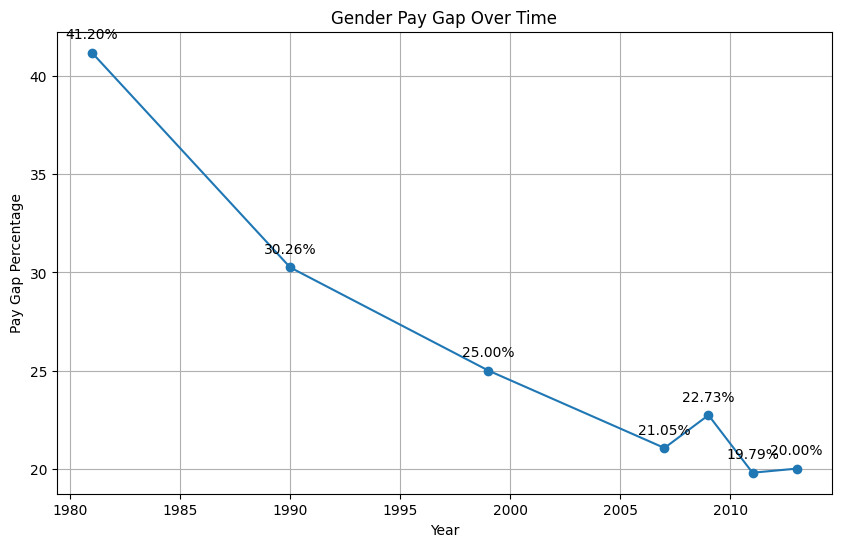

In [23]:
# Extract years and pay gap percentages from the pay_gaps list
years = [gap['year'] for gap in pay_gaps]
percentages = [gap['pay_gap_percentage'] for gap in pay_gaps]

# Create the plot
plt.figure(figsize=(10, 6))
plt.plot(years, percentages, marker='o')

# Customize the plot
plt.title('Gender Pay Gap Over Time')
plt.xlabel('Year')
plt.ylabel('Pay Gap Percentage')
plt.grid(True)

# Add labels to the data points
for i, txt in enumerate(percentages):
    plt.annotate(f'{txt:.2f}%', (years[i], percentages[i]), textcoords="offset points", xytext=(0,10), ha='center')

# Display the plot
plt.show()

Forcasting! When will the pay gap reach 0?

Visualization 
1. The gender gap tends to widen as individuals age - the disparity is already much larger with the maximum hourly wage

In this study, this was done by examining the gap in terms of the years of experience.

In [24]:
gender_group2=PSID.groupby(by=['yrsexp','wave','sex'])
stats2=gender_group2.agg({'hrwage':['min', 'mean','median','max','std']}).reset_index()
print(stats2)

    yrsexp  wave sex     hrwage                                            
                            min       mean     median        max        std
0      0.0  1981   2  17.058510  17.058510  17.058510  17.058510        NaN
1      0.0  1990   2   7.600950   7.600950   7.600950   7.600950        NaN
2      0.0  1999   2   6.976744   6.976744   6.976744   6.976744        NaN
3      0.0  2007   1   8.000000   8.000000   8.000000   8.000000        NaN
4      0.0  2007   2   5.000000   7.000000   5.500000  10.500000   3.041381
..     ...   ...  ..        ...        ...        ...        ...        ...
564   46.0  1981   1   4.027927   9.359062  10.196300  13.610315   3.541400
565   46.0  1981   2   4.640371   4.640371   4.640371   4.640371        NaN
566   46.0  1990   1   2.806123  10.419207   3.986667  24.464832  12.178182
567   46.0  1990   2   2.721088  11.369972  11.734694  19.689737   7.329711
568   46.0  2009   2   5.613306   5.613306   5.613306   5.613306        NaN

[569 rows x

In [25]:
df = PSID
df_sorted = df.sort_values(by='wave')
# add a slider for the year
fig = px.box(df_sorted, x="yrsexp", y="hrwage", animation_frame="wave", color="sex")
fig.update_traces(quartilemethod="exclusive")
fig["layout"].pop("updatemenus") # optional, drop animation buttons
fig.show()

2. It varies considerably by occupation 

What is the pay by job?

What are the jobs: manager, business, financialop, computer, architect, scientist, socialworker, postseceduc, legaleduc, artist, lawyerphysician, healthcare, healthsupport, protective, foodcare, building, sales, officeadmin, farmer, production, transport, constructextractinstall


In [26]:
# hourly
def salarystatsbyjob(job, wage):
    grouped = CPS.groupby(['year',job, 'sex'])
    average_salary=grouped.agg({wage:['min', 'mean','median', 'max','std']}).reset_index()
    print(average_salary)
    return average_salary
joblist= ["manager", "business", "financialop","computer", "architect", "scientist", "socialworker", "postseceduc", "legaleduc", "artist", "lawyerphysician", "healthcare", "healthsupport", "protective", "foodcare", "building", "sales", "officeadmin", "farmer", "production", "transport", "constructextractinstall"]

In [27]:
df = CPS
df["job"] = df[joblist].idxmax(axis=1) # new column called job with only the 1 from the 1 hot encoding
# add a slider for the year

fig = px.box(df, x="job", y="incwage", animation_frame="year", color="sex")
fig.update_traces(quartilemethod="exclusive")
fig["layout"].pop("updatemenus") # optional, drop animation buttons
fig.show()

/tmp/ipykernel_17/1384572200.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



By visualization, in the year 1990, when the wave begins,the gap for a manager is much different from the gap for farmer. The distribution for the manager is pathetic, women's top of the boxplot is almost at the bottom of the boxplot for men. The median line of the men's distribution is roughly at the top of the boxplot for women. For farmer the boxplots are more closely coupled. So there is a huge various between occupations. By 2013 the distributions of lawyerphysician and farmer are almost opposite. The distribution for farmers are short and the medians, while not side by side, are now top to median. The distribution for lawyerphysician is very long and even the length between medians is tall. There may be some distributions that have similar features, but non are completely identical, in terms of length of boxplot, median, and all the other corresponding statistics.

Categorizing the jobs- white collar, blue collar, pink collar.

In [28]:
df = CPS

#categorization via chatGPT
typejp=["socialworker", "artist" ,"healthcare","healthsupport","foodcare"]
typejw=["manager","business","financialop","computer", "architect", "scientist", "postseceduc","legaleduc", "lawyerphysician","sales", "officeadmin"]
typejb=["protective","building", "farmer","production","transport", "constructextractinstall"]

df["job"] = df[joblist].idxmax(axis=1)

#put in the dataframe
df["job_color"]="white"
df["job_color"].loc[df["job"].isin(typejp)]="pink"
df["job_color"].loc[df["job"].isin(typejw)]="white"
df["job_color"].loc[df["job"].isin(typejb)]="blue"

# add a slider for the year

fig = px.box(df, x="job_color", y="incwage", animation_frame="year", color="sex")
fig.update_traces(quartilemethod="exclusive")
fig["layout"].pop("updatemenus") # optional, drop animation buttons
fig.show()

/tmp/ipykernel_17/105938648.py:8: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_17/105938648.py:11: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_17/105938648.py:12: FutureWarning:

ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series,

What we see is that the careers that are the most lucrative, given by the white collar category, have the largest spread between medians (corresponding to the largest pay gap).  
While they are no longer currently male dominated, we can consider them to be historically male dominated.  Furthermore, society has an implicit hierarchy over which jobs are compensated more, and gender is very much a part of it. 

In Legally Blonde, it is no accident that the most prestigious school to attend is Harvard Law School, where law was a historically male dominated profession, and women were not admitted until the 1950s, even if today there is parity of admission. While today, the class is over 50% female, women in legal professions are still penalized for taking time off for mommyhood, and for acting in ways that are classically feminine/ not strictly masculine-professional when trying to make partner.

We see that the second largest gap is for the less lucrative field of blue-collar jobs, which is definitely currently male dominated. And lastly the industries that pay the least and are classically female dominated have the least difference in pay between men and women. And yet, they themselves still have a gap that is non trivial, and almost begs the question, why should men be compensated more for professions that are historically and currently female dominated? Do the male social workers outshine the female social workers?

Hours worked: 
3. And non‐linear returns to hours worked in certain professions drive the gap. 
In 2013, for example, the median hours worked by men is greater than or exactly equal to the median hours worked by women(where the pay gap is calculated from) in every single occupation, across all categories of occupations (white collar, blue collar, pink collar).
In one of the most lucrative professions, lawyerphysician, men work significantly more hours based on the median (2600 hours vs.2340) & q3 (3060 hours vs.2704) without even considering the outliers.
To answer one of the above questions, socialworkers worked the same median hours for men and women, yet the q3 is higher for men(2340 vs. 2080). So the pay gap, which is calculated from the median should not exist in theory for social workers, since they work the same # of hours at the median, and yet, a non trivial gap exists, even in social work. So the only way to account for this is the non linear return for hours. 
And by extension to show that when you depart from the median and hit q3, men work more hours than women, EVEN in classicially female dominated professions, which is why the gap is widened as you depart from the median and tend towards the maximum compensation.

In [29]:
df = CPS
# add a slider for the year
fig = px.box(df, x="job", y="annhrs", animation_frame="year", color="sex")
fig.update_traces(quartilemethod="exclusive")
fig["layout"].pop("updatemenus") # optional, drop animation buttons
fig.show()

There are other factors one can consider that were not primarily addressed by Claudia in her work, but are provided in this dataset, which can be used for future work. Those factors include race and education.

Education

In [30]:
def salarystatsbyedu(wage):
    # Define mapping for relabeling
    grouped = CPS.groupby(['year','sch', 'sex'])
    average_salary=grouped.agg({wage:['min', 'mean','median', 'max','std']}).reset_index()
    print(average_salary.head())
    return average_salary

edu_salary=salarystatsbyedu('incwage')

   year  sch sex incwage                                            
                     min          mean  median      max          std
0  1981  0.0   1   250.0   8689.682353  7862.0  23059.0  4610.735625
1  1981  0.0   2   900.0   5374.270833  5000.0  13000.0  2784.933856
2  1981  1.0   1   450.0  10237.515152  9286.0  22000.0  4440.470415
3  1981  1.0   2  1230.0   4199.666667  2700.0   9336.0  2741.637193
4  1981  2.0   1  1150.0  10907.927536  9600.0  28000.0  6054.373933


Race

In [31]:
def salarystatsbyrace(wage):
    # Define mapping for relabeling
    CPS['race'] = CPS['race'].replace({
    1: 'White nonhisp',
    2: 'Black nonhisp',
    3: 'Hispanic',
    4: 'Other nonhisp',
    })
    CPS['sex'] = CPS['sex'].replace({
    1: 'male',
    2: 'female',
    })
   
    grouped = CPS.groupby(['year','race', 'sex'])
    average_salary=grouped.agg({wage:['min', 'mean','median', 'max','std']}).reset_index()
    print(average_salary.head())
    return average_salary

race_salary=salarystatsbyrace('incwage')


   year           race     sex incwage                                  \
                                   min          mean   median      max   
0  1981  Black nonhisp  female    40.0   9732.267877   8910.0  50000.0   
1  1981  Black nonhisp    male   200.0  14376.528481  13241.5  50000.0   
2  1981       Hispanic  female    44.0   8580.381890   7500.0  50000.0   
3  1981       Hispanic    male    30.0  14732.667568  13077.5  50000.0   
4  1981  Other nonhisp  female    75.0  10542.758333   9926.0  50000.0   

                
           std  
0  6108.448189  
1  7766.067201  
2  5471.994725  
3  8266.709101  
4  6331.960325  


/tmp/ipykernel_17/1423351871.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_17/1423351871.py:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



# **Conclusion:**

This project leveraged the Kaggle Gender Pay Gap Dataset to investigate the work of Claudia Goldin who received the nobel prize for her work on the gender pay gap.

Some hypotheses that were investigated were (as cited by https://www.cato.org/blog/nobel-prize-winner-claudia-goldin-gender-pay-gap):
1. The gender gap tends to widen as individuals age
This is something that was explored in the EDA. The wages experience the least disparity when they lie in the minimum remuneration. The gap widens as there is movement from the minimum to the mean/median, the gap is typically calculated at the median, and then reaches the maximum divergence at the maximum, which is implicitly the salary of the most experienced workers. This was investigated as years of experience in this study in the end, and not specificallyt at the maximum (but rather the entire boxplot).

2. It varies considerably by occupation. 
This is very true, in this report the different careers had vastly different distributions, even over time as shown by the slider. When they were even bucketed into categories of white collar, blue collar and pink collar a hierarchy was established in terms of classically male dominated professions that are lucrative, currently male dominated professions that are less lucrative, and currently female dominated professions. Even in the female dominated professions a non trivial wage gap exists!

3. Non‐linear returns to hours worked in certain professions drive the gap
This is shown by the different salaries even for performers of both genders at the median. In general, across all occupations men tend to work more hours. 
This was the largest factor according to Claudia for the gap.

4. Her solution: flexibility for workers, as firms in sectors like healthcare, banking, and real estate have already done.
This is not something that can be learned directly from the data. It might be a very good recommendation, as it is coming from a nobel prize winner, but it is not directly derived from the analysis in this project.

My recommendation:
a. Hard negotiation - on an individual level, can this compensate for the non-linear return on hours worked?
b. Pay Transparency - so everyone knows what people are paid, so that system wide gaps will not be tolerated.
c. Even more radical - change society to value the contributions of women so that they are compensated well. Maybe a social worker should earn more than a lawyer?

The report also looks at education level and race to see if there are other factors that contribute to the gap, but Claudia's assertion that the non linearity of return to hours work appears to be the most salient factor of the gap, and issues such as race simply widen a gap that is primarily gender based.

## **When Will the Gap Close?**

When will the pay gap close? 

What does ChatGPT have to say about this?
World Economic Forum (WEF)
The WEF's Global Gender Gap Report 2020 estimated: **257** years.
The Institute for Women's Policy Research (IWPR): by **2059**.  

What about the models that are used?
Machine Learning Models- Regression Models (Linear Regression, Polynomial Regression),  Time Series Forecasting (ARIMA, LSTM),
Classification Models (Decision Trees and Random Forests, Gradient Boosting Machines), Clustering Models (K-Means Clustering,  Hierarchical Clustering),Deep Learning Models (Neural Networks, Convolutional Neural Networks (CNN)).